# Лабораторная работа №2 - линейный дискриминантный анализ.

## Задание 1   
Используя функцию make_blobs с любым random_state, сгенерировать датасет df1, в
котором есть три класса с размером каждого класса 1000 объектов и 16 количественных
(недискретных) признаков. Распределения двух из трех классов должны значительно
перекрывать друг друга, тогда как третий класс должен быть на расстоянии от первых
двух классов.

In [1]:
from timeit import default_timer as timer

import numpy as np
import pandas as pd
from scipy import stats
from sklearn.datasets import make_blobs
from sklearn.discriminant_analysis import LinearDiscriminantAnalysis, QuadraticDiscriminantAnalysis
from sklearn.metrics import auc
from sklearn.metrics import confusion_matrix
from sklearn.utils import resample
from sklearn.model_selection import StratifiedKFold
from matplotlib import pyplot as plt
from matplotlib.markers import MarkerStyle
import seaborn as sns


PALETTE = "crest"


def describe_dataset(df: pd.DataFrame, hue: str) -> pd.DataFrame:
    class_labels = df[hue].unique().tolist()
    col_names = ["Size", "Features", "Classes"] + class_labels + ["Undefined"]
    undefined = round((df.isna().any(axis=1).sum() / df.shape[0]) * 100, 3)
    cells = [[df.shape[0], len(df.columns) - 1, len(class_labels)] + df[hue].value_counts().to_list() + [undefined]]
    return pd.DataFrame(cells, columns=col_names)


centers = np.array([np.repeat(-1, 16), np.repeat(0.5, 16), np.repeat(7, 16)])
X, y = make_blobs(3000, 16, centers=centers, random_state=42, shuffle=False)

df_n = {}
df_n[1] = pd.DataFrame(np.concat((X, y.reshape(-1, 1)), 1))
df_n[1].rename(columns=lambda i: f"Feature_{i}" if i != 16 else "Class", inplace=True)

print("Common inforamtion about df1:")
print(describe_dataset(df_n[1], "Class"))

Common inforamtion about df1:
   Size  Features  Classes   0.0   1.0   2.0  Undefined
0  3000        16        3  1000  1000  1000        0.0


### Визуализация распределения сгенерированного датасета

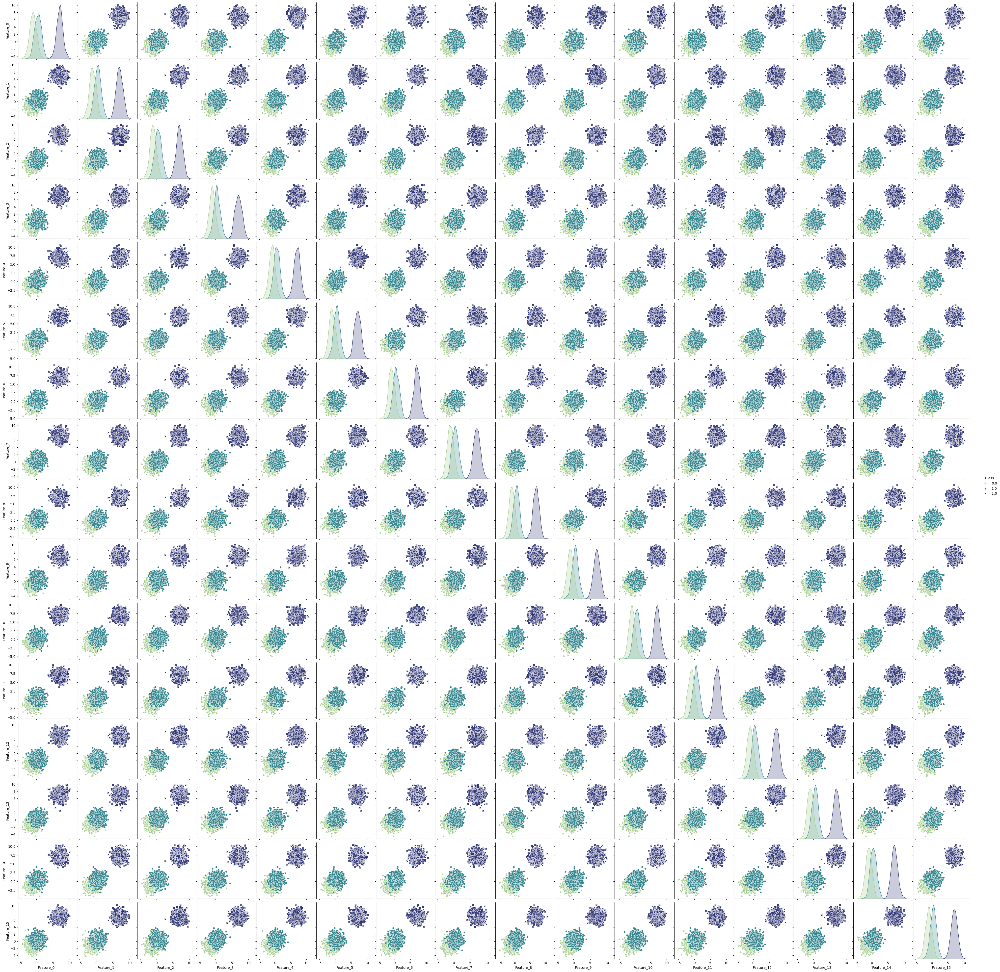

In [ ]:
class_labels = df_n[1]["Class"].unique().tolist()
class_markers = {}
for i, class_label in enumerate(class_labels):
    class_markers[class_label] = MarkerStyle.filled_markers[(i + 1) * 5]

sns.pairplot(df_n[1], hue="Class", markers=list(class_markers.values()), palette=PALETTE)
plt.show()

### Демонстрация матриц корреляций по всем признакам



PEARSON

All objects:
      feature_1   feature_2      corr  p_value
0     Feature_0   Feature_0  1.000000      0.0
1     Feature_0   Feature_1  0.923184      0.0
2     Feature_0   Feature_2  0.925744      0.0
3     Feature_0   Feature_3  0.920229      0.0
4     Feature_0   Feature_4  0.921650      0.0
..          ...         ...       ...      ...
251  Feature_15  Feature_11  0.923241      0.0
252  Feature_15  Feature_12  0.923212      0.0
253  Feature_15  Feature_13  0.925898      0.0
254  Feature_15  Feature_14  0.923481      0.0
255  Feature_15  Feature_15  1.000000      0.0

[256 rows x 4 columns]

0.0:
      feature_1   feature_2      corr   p_value
0     Feature_0   Feature_0  1.000000  0.000000
1     Feature_0   Feature_1 -0.014142  0.655102
2     Feature_0   Feature_2  0.025595  0.418796
3     Feature_0   Feature_3 -0.067505  0.032806
4     Feature_0   Feature_4 -0.040334  0.202526
..          ...         ...       ...       ...
251  Feature_15  Feature_11 -0.042369  0.18065

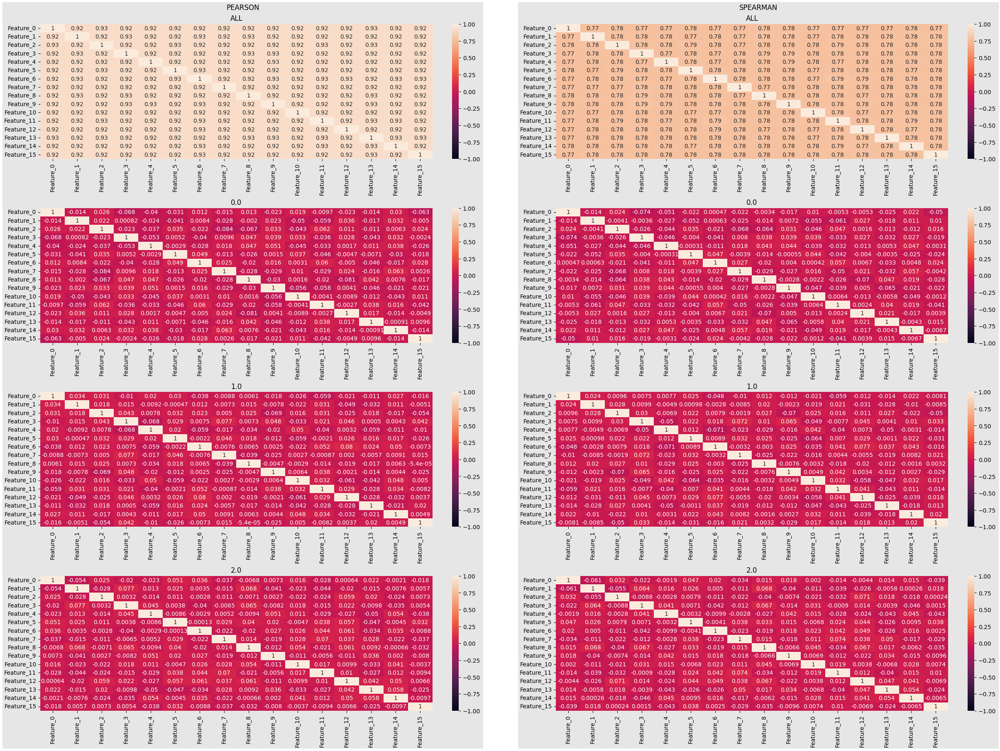

In [4]:
def compute_corr_matrix(df: pd.DataFrame, method: str) -> tuple[pd.DataFrame, pd.DataFrame]:
    corr_and_p_value_matrix = []
    corr_matrix = pd.DataFrame(index=df.columns, columns=df.columns, dtype=float)
    corr_func = stats.pearsonr if method == "pearson" else stats.spearmanr

    for feature_1 in df.columns:
        for feature_2 in df.columns:
            res = corr_func(df[feature_1], df[feature_2])
            corr_matrix.at[feature_1, feature_2] = res.statistic
            corr_and_p_value_matrix.append({"feature_1": feature_1, 
                                            "feature_2": feature_2, 
                                            "corr": res.statistic, 
                                            "p_value": res.pvalue})

    return corr_matrix, pd.DataFrame(corr_and_p_value_matrix)


def draw_corr_matrices(all_objects: pd.DataFrame, objects_by_class: dict, class_labels: list) -> plt.Figure:
    fig = plt.figure(layout="constrained", figsize=[24, 18])
    subfigs = fig.subfigures(1, 2, wspace=0.07)

    for i, method in enumerate(["pearson", "spearman"]):
        print("\n\n", method.upper(), "\n", sep="")
        subfigs[i].suptitle(method.upper())
        subfigs[i].set_facecolor("0.9")
        axs = subfigs[i].subplots(4, 1)

        corr_matrix, corr_and_p_value_matrix = compute_corr_matrix(all_objects, method)
        print("All objects:", "\n", corr_and_p_value_matrix, sep="")
        sns.heatmap(corr_matrix, annot=True, ax=axs[0], vmin=-1, vmax=1)
        axs[0].set_title("ALL")
        for j, class_label in enumerate(class_labels):
            corr_matrix, corr_and_p_value_matrix = compute_corr_matrix(objects_by_class[class_label], method)
            print("\n", class_label, ":\n", corr_and_p_value_matrix, sep="")
            sns.heatmap(corr_matrix, annot=True, ax=axs[j + 1], vmin=-1, vmax=1)
            axs[j + 1].set_title(class_label)

    return fig


all_objects = df_n[1].drop(["Class"], axis=1)
objects_by_class = dict()
for class_label in class_labels:
    objects_by_class[class_label] = all_objects[df_n[1]["Class"] == class_label]

corr_matrices_fig = draw_corr_matrices(all_objects, objects_by_class, class_labels)
plt.show()

## Задание 2  
На основе созданного в пункте [1] датасета df1 сгенерировать отдельные
дополнительные датасеты (df2, df5, df10...), в которых объекты одного класса (который
имеет пересечение с другим) повторены 2 раза, 5 раз, 10 раз, 20 раз, 50 раз, 100 раз,
1000 раз, 10k раз, а количество объектов в остальных классах осталось неизменно.

In [2]:
def repeat_objs_n_times(df: pd.DataFrame, cond, n: int) -> pd.DataFrame:
    return pd.concat([df] + [df[cond]] * (n - 1), ignore_index=True)


N = [2, 5, 10, 20, 50, 100, 1000, 10000]

for i, n in enumerate(N):
    df_n[n] = repeat_objs_n_times(df_n[1], df_n[1]["Class"] == 0, n)
    print(f"Common inforamtion about df{n}:")
    display(describe_dataset(df_n[n], "Class"))
    print()

N = [1] + N

Common inforamtion about df2:


,Size,Features,Classes,0.0,1.0,2.0,Undefined
0,4000,16,3,2000,1000,1000,0.0



Common inforamtion about df5:


,Size,Features,Classes,0.0,1.0,2.0,Undefined
0,7000,16,3,5000,1000,1000,0.0



Common inforamtion about df10:


,Size,Features,Classes,0.0,1.0,2.0,Undefined
0,12000,16,3,10000,1000,1000,0.0



Common inforamtion about df20:


,Size,Features,Classes,0.0,1.0,2.0,Undefined
0,22000,16,3,20000,1000,1000,0.0



Common inforamtion about df50:


,Size,Features,Classes,0.0,1.0,2.0,Undefined
0,52000,16,3,50000,1000,1000,0.0



Common inforamtion about df100:


,Size,Features,Classes,0.0,1.0,2.0,Undefined
0,102000,16,3,100000,1000,1000,0.0



Common inforamtion about df1000:


,Size,Features,Classes,0.0,1.0,2.0,Undefined
0,1002000,16,3,1000000,1000,1000,0.0



Common inforamtion about df10000:


,Size,Features,Classes,0.0,1.0,2.0,Undefined
0,10002000,16,3,10000000,1000,1000,0.0


## Функции для заданий 3-6

### Набор функций для визуализации решающей функции LDA

In [3]:
def draw_da(estimator: LinearDiscriminantAnalysis | QuadraticDiscriminantAnalysis, x: pd.DataFrame, y: pd.Series, ax: plt.Axes) -> None:
    x1_min, x1_max = x["Feature_0"].min() - 1, x["Feature_0"].max() + 1
    x2_min, x2_max = x["Feature_1"].min() - 1, x["Feature_1"].max() + 1
    xx1, xx2 = np.meshgrid(np.arange(x1_min, x1_max, 0.02), np.arange(x2_min, x2_max, 0.02))
    grid_points = np.c_[xx1.ravel(), xx2.ravel()] 
    z = estimator.predict(pd.DataFrame(grid_points, columns=["Feature_0", "Feature_1"]))
    z = z.reshape(xx1.shape)

    # Области, точки и разделяющая прямая
    ax.contourf(xx1, xx2, z, alpha=0.3, cmap=plt.cm.Paired)
    sns.scatterplot(x=x["Feature_0"], y=x["Feature_1"], 
                    hue=y, palette=PALETTE, edgecolor="black", s=80, alpha=0.8, ax=ax)
    ax.contour(xx1, xx2, z, colors="red", linewidths=2, alpha=0.8)


def extract_centers_from_lda(lda: LinearDiscriminantAnalysis, x: pd.DataFrame) -> pd.DataFrame:
    classes_centers = lda.means_
    middle_of_line = [(classes_centers[0][0] + classes_centers[1][0]) / 2, (classes_centers[0][1] + classes_centers[1][1]) / 2]
    return pd.DataFrame({"Class_0": classes_centers[0,:], 
                         "Class_1": classes_centers[1,:],
                         "Common": [x["Feature_0"].mean(), x["Feature_1"].mean()], 
                         "Middle": middle_of_line}, 
                         index=["x", "y"])


def add_centers_to_lda_fig(ax: plt.Axes, lda_centers: pd.DataFrame) -> None:
    # Прямая и центры масс классов
    ax.scatter([lda_centers.at["x", "Class_0"], lda_centers.at["x", "Class_1"]],
               [lda_centers.at["y", "Class_0"], lda_centers.at["y", "Class_1"]],
               s=80, edgecolors="black", c="m")
    ax.plot([lda_centers.at["x", "Class_0"], lda_centers.at["x", "Class_1"]],
            [lda_centers.at["y", "Class_0"], lda_centers.at["y", "Class_1"]], 
            linewidth=3, c="m", label="Class centers")

    # Общий центр масс
    ax.scatter(lda_centers.at["x", "Common"], lda_centers.at["y", "Common"],
               s=80, c="black", zorder=3, label="Common center")
    
    # Середина отрезка
    ax.scatter(lda_centers.at["x", "Middle"], lda_centers.at["y", "Middle"],
               s=80, c="white", edgecolors="black", alpha=0.6, zorder=3, label="Middle")

### Функции для расчёта и визуализации confidence bands по бутстрап выборкам

In [4]:
def compute_ci(arr: np.ndarray, ci: float):
    alpha = (1 - ci) / 2 
    percentiles = [100 * alpha, 100 * (1 - alpha)]
    return np.percentile(arr, percentiles, 0)


def draw_ci(x_metric_mean: np.ndarray, y_metric_ci: np.ndarray, ci: float, ax: plt.Axes, color: str = "b"):
    ax.fill_between(x_metric_mean, y_metric_ci[0], y_metric_ci[1], color=color, linewidth=2, alpha=0.3, label=f"ci = {ci:.2f}")

### Функции для расчёта и визуализации ROC curve

In [10]:
def specifity(TN: int, FP: int) -> float:
    return TN / (FP + TN) if (FP + TN) != 0 else 0


def sensitivity(TP: int, FN: int) -> float:
    return TP / (TP + FN) if (TP + FN) != 0 else 0


def compute_spec_and_sens(y_true: np.ndarray, y_pred: np.ndarray) -> tuple[float, float]:
    conf_matrix = confusion_matrix(y_true, y_pred, labels=[0, 1])
    return specifity(conf_matrix[0, 0], conf_matrix[0, 1]), sensitivity(conf_matrix[1, 1], conf_matrix[1, 0])


def compute_roc_curve(y_true: np.ndarray, y_probs: np.ndarray, specifity_mean: np.ndarray,
                      thresholds: np.ndarray, compute_auc: bool = True) -> tuple[np.ndarray, float | None]:
    specifity_values = np.ndarray((thresholds.size))
    sensitivity_values = np.ndarray((thresholds.size))
    for i, threshold in enumerate(thresholds):
        y_pred = y_probs >= threshold
        specifity_values[i], sensitivity_values[i] = compute_spec_and_sens(y_true, y_pred)
    sensitivity_interp = np.interp(specifity_mean, specifity_values, sensitivity_values)
    auroc = auc(specifity_mean, sensitivity_interp) if compute_auc else None
    return sensitivity_interp, auroc


def draw_roc(specifity_mean: np.ndarray, sensitivity_interp: np.ndarray, auroc: float, ax: plt.Axes, color: str = "b"):
    ax.plot(specifity_mean, sensitivity_interp, color+"-", linewidth=3, label=f"ROC curve, AUROC = {auroc:.3f}")
    ax.set_xlim(1, 0)
    ax.set_xlabel("specifity")
    ax.set_ylim(0, 1)
    ax.set_ylabel("sensitivity")
    ax.grid()


def compute_roc_ci(specifity_mean: np.ndarray, y_true: pd.Series, y_probs: np.ndarray, 
                   n: int, ci: float, thresholds: np.ndarray) -> np.ndarray:
    sensitivity_interps = np.ndarray((n, 100))
    for i in range(n):
        y_true_resampled, y_probs_resampled = resample(y_true, y_probs, random_state=i, n_samples=10000, stratify=y_true)
        sensitivity_interps[i], _ = compute_roc_curve(y_true_resampled, y_probs_resampled, specifity_mean, thresholds, False)
    return compute_ci(sensitivity_interps, ci)


### Функции для расчёта и визуализации PR curve

In [11]:
def precision(TP: int, FP: int) -> float:
    return TP / (TP + FP) if (TP + FP) > 0 else 0


def recall(TP: int, FN: int) -> float:
    return sensitivity(TP, FN)


def compute_p_and_r(y_true: np.ndarray, y_pred: np.ndarray) -> tuple[float]:
    conf_matrix = confusion_matrix(y_true, y_pred, labels=[0, 1])
    return precision(conf_matrix[1, 1], conf_matrix[0, 1]), recall(conf_matrix[1, 1], conf_matrix[1, 0])


def compute_pr_curve(y_true: np.ndarray, y_probs: np.ndarray, recall_mean: np.ndarray,
                    thresholds: np.ndarray, compute_auc: bool = True) -> tuple[np.ndarray, float | None]:
    precision_values = np.ndarray((thresholds.size))
    recall_values = np.ndarray((thresholds.size))

    for i, threshold in enumerate(thresholds):
        y_pred = y_probs >= threshold
        precision_values[i], recall_values[i] = compute_p_and_r(y_true, y_pred)
    final_precision_values = np.where(precision_values == 0, 1, precision_values)

    sorted_indices = recall_values.argsort()
    sorted_precision_values = final_precision_values[sorted_indices]
    sorted_recall_values = recall_values[sorted_indices]

    precision_iterp = np.interp(recall_mean, sorted_recall_values, sorted_precision_values)
    auprc = auc(recall_mean, precision_iterp) if compute_auc else None

    return precision_iterp, auprc


def draw_pr(recall_mean: np.ndarray, precision_interp: np.ndarray, auprc: float, ax: plt.Axes, color: str = "b"):
    ax.scatter(recall_mean[-1], precision_interp[-1], c=color, s=80, zorder=3, label="t_0 = 0")
    ax.plot(recall_mean, precision_interp, color+"-", linewidth=3, label=f"PR curve, AUPRC = {auprc:.3f}")
    ax.set_xlim(0, 1)
    ax.set_xlabel("recall")
    ax.set_ylim(0, 1)
    ax.set_ylabel("precision")
    ax.grid()


def draw_baseline(baseline: float, ax: plt.Axes, c: str = "b"):
    ax.axhline(baseline, ls="--", c=c, label=f"baseline = {baseline:.2f}")


def compute_pr_ci(recall_mean: np.ndarray, y_true: pd.Series, y_probs: np.ndarray, 
                  n: int, ci: float, thresholds: np.ndarray) -> np.ndarray:
    precision_interps = np.ndarray((n, 100))
    for i in range(n):
        y_true_resampled, y_probs_resampled = resample(y_true, y_probs, random_state=i, n_samples=10000, stratify=y_true)
        precision_interps[i], _ = compute_pr_curve(y_true_resampled, y_probs_resampled, recall_mean, thresholds, False)
    return compute_ci(precision_interps, ci)

## Задания 3-5  
3. Выбрать пару классов (включая класс с повторенными объектами) и пару
количественных признаков. Используя метод LDA (линейный дискриминантный анализ),
для каждого из сформированных датасетов df1, df2, df5, df10, df20, df50, df100, df1000,
df10k, графически построить решающую функцию алгоритма, разграниченные решающей
функцией зоны и отдельные объекты классов; отдельно вывести время построения
решения.  
  
4. Для датасетов df1, df2, df5, df10, df20, df50, df100, df1000 из пункта [3] восстановить в
таблицу координаты следующих точек:  
-- центры масс каждого класса;  
-- общий центр масс выбранных классов;  
-- центр отрезка, соединяющего центры масс выбранных классов.  
Для датасетов отдельно на графиках с решающей функцией LDA вывести положения
центров масс и соединяющий центры масс классов отрезок с его центральной точкой.  
  
5. Выбрать целевой класс для решений из пункта [3].
Для каждого из решений из пункта [3], оценить качество работы полученных на основе
LDA классификаторов, используя ROC кривые и восстановив на графике ROC кривой
соответствующие решению LDA 95% доверительные полосы (Confidence bands 95%)
ROC кривой бутстрепом (n=1000 или больше). Для каждой кривой численно также
отобразить метрику AUROС (AUC для ROC кривой классификации Sensitivity-Specificity и
ее доверительные интервалы CI95).

df1
Time spent on making a solution: 0.2445 ms
Centers:


,Class_0,Class_1,Common,Middle
x,-1.002310,0.448389,-0.276960,-0.276960
y,-1.027733,0.477096,-0.275318,-0.275318



df2
Time spent on making a solution: 0.1513 ms
Centers:


,Class_0,Class_1,Common,Middle
x,-1.002310,0.448389,-0.518743,-0.276960
y,-1.027733,0.477096,-0.526123,-0.275318



df5
Time spent on making a solution: 0.1850 ms
Centers:


,Class_0,Class_1,Common,Middle
x,-1.002310,0.448389,-0.760526,-0.276960
y,-1.027733,0.477096,-0.776928,-0.275318



df10
Time spent on making a solution: 0.2312 ms
Centers:


,Class_0,Class_1,Common,Middle
x,-1.002310,0.448389,-0.870428,-0.276960
y,-1.027733,0.477096,-0.890930,-0.275318



df20
Time spent on making a solution: 0.4075 ms
Centers:


,Class_0,Class_1,Common,Middle
x,-1.002310,0.448389,-0.933229,-0.276960
y,-1.027733,0.477096,-0.956074,-0.275318



df50
Time spent on making a solution: 0.7371 ms
Centers:


,Class_0,Class_1,Common,Middle
x,-1.002310,0.448389,-0.973864,-0.276960
y,-1.027733,0.477096,-0.998227,-0.275318



df100
Time spent on making a solution: 1.6385 ms
Centers:


,Class_0,Class_1,Common,Middle
x,-1.002310,0.448389,-0.987946,-0.276960
y,-1.027733,0.477096,-1.012834,-0.275318



df1000
Time spent on making a solution: 22.0298 ms
Centers:


,Class_0,Class_1,Common,Middle
x,-1.002310,0.448389,-1.00086,-0.276960
y,-1.027733,0.477096,-1.02623,-0.275318



df10000
Time spent on making a solution: 176.9774 ms
Centers:


,Class_0,Class_1,Common,Middle
x,-1.002310,0.448389,-1.002164,-0.276960
y,-1.027733,0.477096,-1.027582,-0.275318


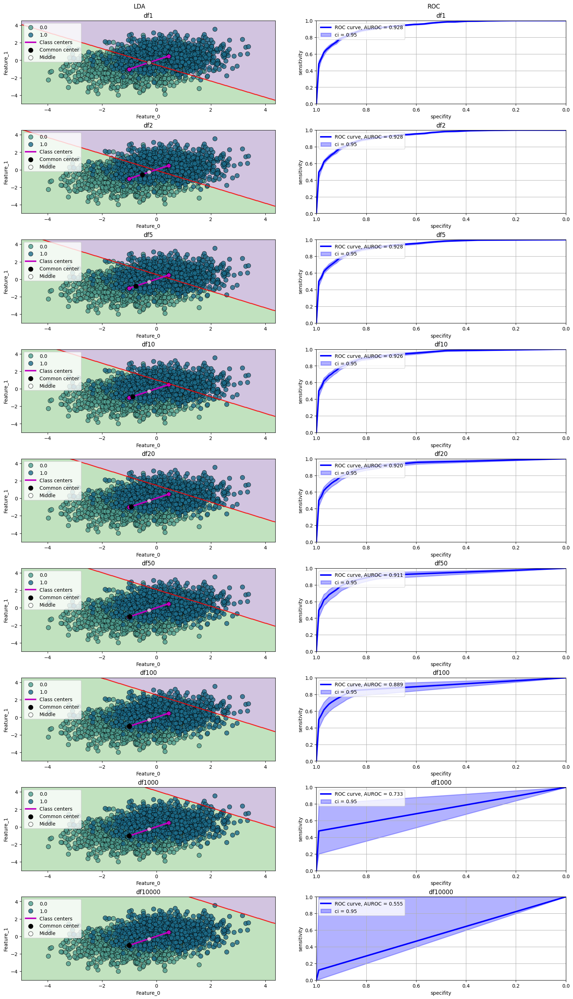

In [12]:
N_BOOTSTRAPS = 1000
CLASS_0 = 0
CLASS_1 = 1
FEATURES = ["Feature_0", "Feature_1"]
ci = 0.95

nrows = len(N)
fig = plt.figure(layout="constrained", figsize=[16, 28])
subfigs = fig.subfigures(1, 2, wspace=0.07)
lda_axs = subfigs[0].subplots(nrows, 1)
subfigs[0].suptitle("LDA")
roc_axs = subfigs[1].subplots(nrows, 1)
subfigs[1].suptitle("ROC")

thresholds = np.concat((np.linspace(0, 1, 100), [np.inf]))
specifity_mean = np.linspace(0, 1, 100)
X_TO_DRAW = df_n[1][(df_n[1]["Class"] == CLASS_0) | (df_n[1]["Class"] == CLASS_1)][FEATURES]
for i, n in enumerate(N):
    LDA = LinearDiscriminantAnalysis()
    samples = df_n[n][(df_n[n]["Class"] == CLASS_0) | (df_n[n]["Class"] == CLASS_1)]
    x = samples[FEATURES]
    y = samples["Class"]
    y_binary = y == CLASS_1
    
    start = timer()
    LDA.fit(x, y_binary)
    end = timer()
    fitting_time = (end - start) * 100

    draw_da(LDA, X_TO_DRAW, y, lda_axs[i])
    lda_centers = extract_centers_from_lda(LDA, x)
    add_centers_to_lda_fig(lda_axs[i], lda_centers)
    lda_axs[i].set_title(f"df{n}")
    lda_axs[i].set_xlabel("Feature_0")
    lda_axs[i].set_ylabel("Feature_1")
    lda_axs[i].legend(loc="upper left")

    y_probs = LDA.predict_proba(x)[:, 1]
    sensitivity_interp, auroc = compute_roc_curve(y_binary, y_probs, specifity_mean, thresholds)
    draw_roc(specifity_mean, sensitivity_interp, auroc, roc_axs[i])
    sensitivity_ci = compute_roc_ci(specifity_mean, y_binary, y_probs, N_BOOTSTRAPS, ci, thresholds)
    draw_ci(specifity_mean, sensitivity_ci, ci, roc_axs[i])
    roc_axs[i].set_title(f"df{n}")
    roc_axs[i].legend(loc="upper left")

    print(f"df{n}")
    print(f"Time spent on making a solution: {fitting_time:.4f} ms")
    print("Centers:")
    display(lda_centers)
    print()

## Задание 6  
Повторить пункт [5] для PR кривых и отобразить метрику AUPRC (AUC для PR).

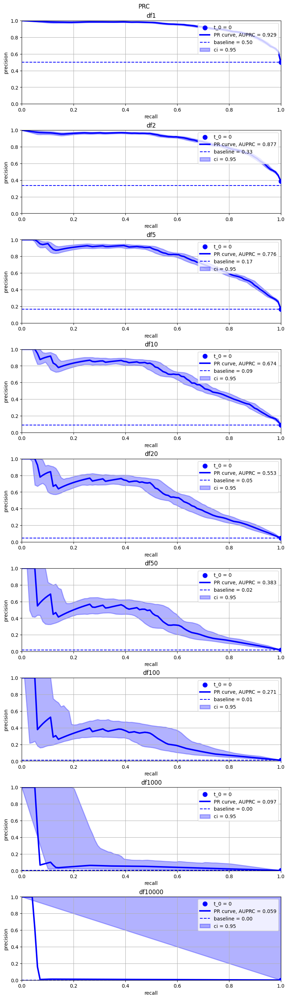

In [14]:
N_BOOTSTRAPS = 1000
CLASS_0 = 0
CLASS_1 = 1
FEATURES = ["Feature_0", "Feature_1"]
ci = 0.95

fig, pr_axs = plt.subplots(len(N), 1, layout="constrained", figsize=[8, 28])
fig.suptitle("PRC")

thresholds = np.linspace(0, 1, 100)
recall_mean = np.linspace(0, 1, 100)
for i, n in enumerate(N):
    LDA = LinearDiscriminantAnalysis()
    samples = df_n[n][(df_n[n]["Class"] == CLASS_0) | (df_n[n]["Class"] == CLASS_1)]
    x = samples[FEATURES]
    y_binary = samples["Class"] == CLASS_1
    LDA.fit(x, y_binary)

    sizes_of_classes = y_binary.value_counts()
    baseline = sizes_of_classes[True] / (sizes_of_classes[True] + sizes_of_classes[False])

    y_probs = LDA.predict_proba(x)[:, 1]
    precision_interp, auprc = compute_pr_curve(y_binary, y_probs, recall_mean, thresholds)
    draw_pr(recall_mean, precision_interp, auprc, pr_axs[i])
    draw_baseline(baseline, pr_axs[i])
    precision_ci = compute_pr_ci(recall_mean, y_binary, y_probs, N_BOOTSTRAPS, ci, thresholds)
    draw_ci(recall_mean, precision_ci, ci, pr_axs[i])
    pr_axs[i].set_title(f"df{n}")
    pr_axs[i].legend(loc="upper right")

## Задание 7  
В пункте [5] выбрать другой целевой класс и повторить отдельно визуализации ROC
кривых.

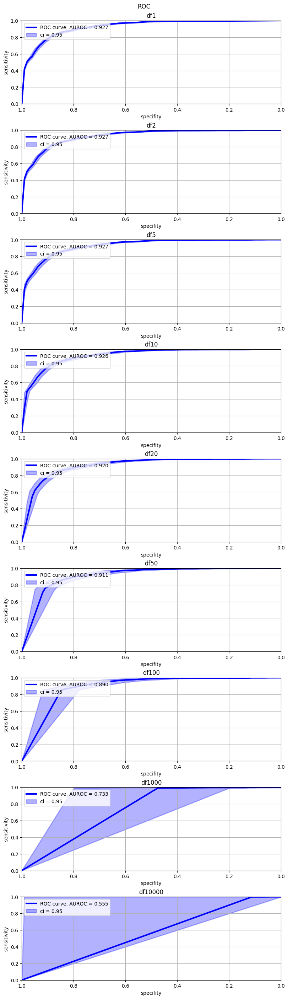

In [16]:
N_BOOTSTRAPS = 1000
CLASS_0 = 1
CLASS_1 = 0
FEATURES = ["Feature_0", "Feature_1"]
ci = 0.95

fig, roc_axs = plt.subplots(len(N), 1, layout="constrained", figsize=[8, 28])
fig.suptitle("ROC")

thresholds = np.linspace(0, 1, 100)
specifity_mean = np.linspace(0, 1, 100)
for i, n in enumerate(N):
    LDA = LinearDiscriminantAnalysis()
    samples = df_n[n][(df_n[n]["Class"] == CLASS_0) | (df_n[n]["Class"] == CLASS_1)]
    x = samples[FEATURES]
    y_binary = samples["Class"] == CLASS_1
    LDA.fit(x, y_binary)

    y_probs = LDA.predict_proba(x)[:, 1]
    sensitivity_interp, auroc = compute_roc_curve(y_binary, y_probs, specifity_mean, thresholds)
    draw_roc(specifity_mean, sensitivity_interp, auroc, roc_axs[i])
    sensitivity_ci = compute_roc_ci(specifity_mean, y_binary, y_probs, N_BOOTSTRAPS, ci, thresholds)
    draw_ci(specifity_mean, sensitivity_ci, ci, roc_axs[i])
    roc_axs[i].set_title(f"df{n}")
    roc_axs[i].legend(loc="upper left")

## Задание 8
Для датасета df10 на основе 3-fold, 5-fold, 10-fold, 20-fold, 50-fold, 100-fold кросс-
валидации построить кривые AUROC и AUPRC c 95% доверительными полосами (CI95).

In [19]:
def compute_k_fold_lda(x: np.ndarray, y: np.ndarray, k: int) -> tuple[list, list]:
    y_probs = list()
    y_tests = list()
    kf = StratifiedKFold(n_splits=k, shuffle=True, random_state=10)

    for train_index, test_index in kf.split(x, y):
        x_train, x_test = x[train_index], x[test_index]
        y_train, y_test = y[train_index], y[test_index]
        LDA = LinearDiscriminantAnalysis()
        LDA.fit(x_train, y_train)
        y_probs.append(LDA.predict_proba(x_test)[:, 1])
        y_tests.append(y_test)
    
    return y_tests, y_probs


def draw_roc_with_fold_val(x: np.ndarray, y: np.ndarray, thresholds: np.ndarray, 
                           ci: float, k: int, ax: plt.Axes, add_label: bool):
    LDA = LinearDiscriminantAnalysis()
    LDA.fit(x, y)
    y_probs = LDA.predict_proba(x)[:, 1]
    specifity_mean = np.linspace(0, 1, 100)
    sensitivity_interps = np.ndarray((k + 1, 100))
    sensitivity_interps[0], auroc = compute_roc_curve(y, y_probs, specifity_mean, thresholds)
    draw_roc(specifity_mean, sensitivity_interps[0], auroc, ax, color="r")

    i = 0
    for y_tests, y_probs in zip(*compute_k_fold_lda(x, y, k)):
        sensitivity_interps[i + 1], auroc = compute_roc_curve(y_tests, y_probs, specifity_mean, thresholds)
        label = f"Fold {i}, AUROC = {auroc:.3f}" if add_label else None
        ax.plot(specifity_mean, sensitivity_interps[i + 1], c=f"C{i + 1}", ls="-", linewidth=3, alpha = 0.6, 
                label=label)
        i += 1

    sensitivity_ci = compute_ci(sensitivity_interps, ci)
    draw_ci(specifity_mean, sensitivity_ci, ci, ax)


def draw_prc_with_fold_val(x: np.ndarray, y: np.ndarray, thresholds: np.ndarray, 
                           ci: float, k: int, ax: plt.Axes, add_label: bool):
    LDA = LinearDiscriminantAnalysis()
    LDA.fit(x, y)
    y_probs = LDA.predict_proba(x)[:, 1]
    recall_mean = np.linspace(0, 1, 100)
    precision_interps = np.ndarray((k + 1, 100))
    precision_interps[0], auprc = compute_pr_curve(y, y_probs, recall_mean, thresholds)
    draw_pr(recall_mean, precision_interps[0], auprc, ax, color="r")

    i = 0
    for y_tests, y_probs in zip(*compute_k_fold_lda(x, y, k)):
        precision_interps[i + 1], auprc = compute_pr_curve(y_tests, y_probs, recall_mean, thresholds)
        ax.scatter(recall_mean[-1], precision_interps[i + 1][-1], c=f"C{i + 1}", alpha=0.6, s=80, zorder=3)
        label = f"Fold {i}, AUPRC = {auprc:.3f}" if add_label else None
        ax.plot(recall_mean, precision_interps[i + 1], c=f"C{i + 1}", ls="-", linewidth=3,  alpha = 0.6, 
                label=label)
        i += 1

    precision_ci = compute_ci(precision_interps, ci)
    draw_ci(recall_mean, precision_ci, ci, ax)

    target_y_size = np.count_nonzero(y == 1)
    non_target_y_size = np.count_nonzero(y == 0)
    baseline = target_y_size / (target_y_size + non_target_y_size)
    draw_baseline(baseline, ax)

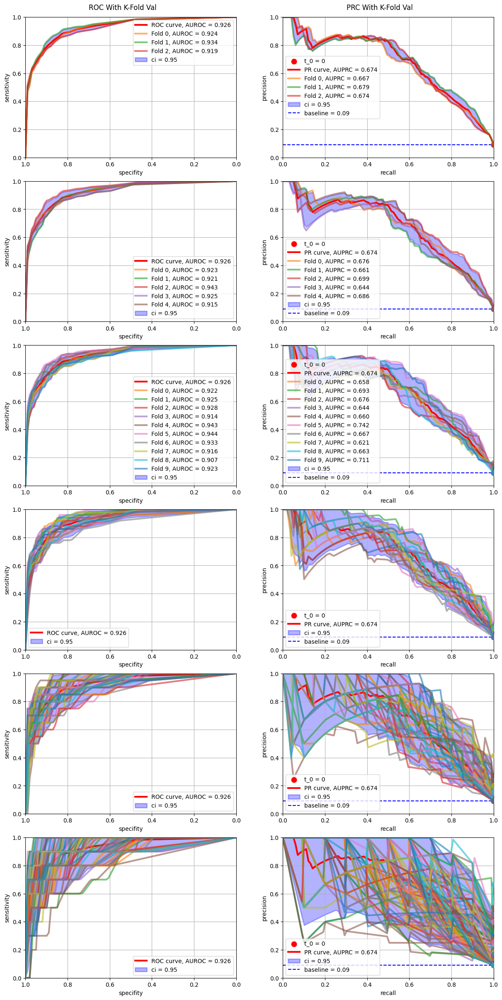

In [20]:
CLASS_0 = 0
CLASS_1 = 1
FEATURES = ["Feature_0", "Feature_1"]
K = [3, 5, 10, 20, 50, 100]
ci = 0.95

thresholds = np.linspace(0, 1, 100)
samples = df_n[10][(df_n[10]["Class"] == CLASS_0) | (df_n[10]["Class"] == CLASS_1)]
x = samples[FEATURES].to_numpy()
y = (samples["Class"] == CLASS_1).to_numpy()

fig = plt.figure(figsize=[12, 24], layout="constrained")
subfigs = fig.subfigures(1, 2, wspace=0.07)
subfigs[0].suptitle("ROC With K-Fold Val")
roc_axs = subfigs[0].subplots(len(K), 1)
subfigs[1].suptitle("PRC With K-Fold Val")
prc_axs = subfigs[1].subplots(len(K), 1)

add_label = True
for i, k in enumerate(K):
    if k > 10:
        add_label = False
    draw_roc_with_fold_val(x, y, thresholds, ci, k, roc_axs[i], add_label)
    roc_axs[i].legend()
    draw_prc_with_fold_val(x, y, thresholds, ci, k, prc_axs[i], add_label)
    prc_axs[i].legend()

## Задание 9
Для датасета df1 построить решения LDA на двух, четырех, восьми и шестнадцати
признаках. Для каждого решения восстановить по пункту [5] ROC кривые с доверительными
полосами 95%.

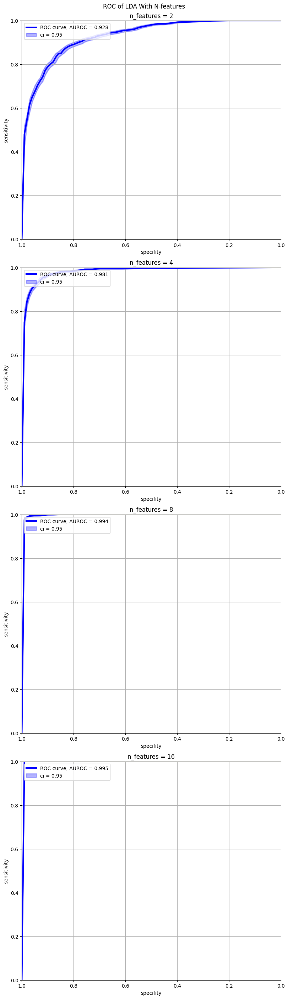

In [22]:
NUM_OF_FEATURES = [2, 4, 8, 16]
N_BOOTSTRAPS = 1000
CLASS_0 = 0
CLASS_1 = 1
ci = 0.95

fig, roc_axs = plt.subplots(len(NUM_OF_FEATURES), 1, layout="constrained", figsize=[8, 28])
fig.suptitle("ROC of LDA With N-features")
thresholds = np.concat((np.linspace(0, 1, 100), [np.inf]))
specifity_mean = np.linspace(0, 1, 100)
samples = df_n[1][(df_n[1]["Class"] == CLASS_0) | (df_n[1]["Class"] == CLASS_1)]

for i, n_features in enumerate(NUM_OF_FEATURES):
    LDA = LinearDiscriminantAnalysis()
    x = samples.iloc[:, :n_features]
    y_binary = samples["Class"] == CLASS_1
    LDA.fit(x, y_binary)

    y_probs = LDA.predict_proba(x)[:, 1]
    sensitivity_interp, auroc = compute_roc_curve(y_binary, y_probs, specifity_mean, thresholds)
    draw_roc(specifity_mean, sensitivity_interp, auroc, roc_axs[i])
    sensitivity_ci = compute_roc_ci(specifity_mean, y_binary, y_probs, N_BOOTSTRAPS, ci, thresholds)
    draw_ci(specifity_mean, sensitivity_ci, ci, roc_axs[i])
    roc_axs[i].set_title(f"n_features = {n_features}")
    roc_axs[i].legend(loc="upper left")

## Задание 10
Повторить пункты [3]+[5] для алгоритма QDA (квадратичный дискриминатный анализ).

df1
Time spent on making a solution: 0.1445 ms
df2
Time spent on making a solution: 0.1227 ms
df5
Time spent on making a solution: 0.1551 ms
df10
Time spent on making a solution: 0.2092 ms
df20
Time spent on making a solution: 0.2618 ms
df50
Time spent on making a solution: 0.4022 ms
df100
Time spent on making a solution: 0.8723 ms
df1000
Time spent on making a solution: 11.8096 ms
df10000
Time spent on making a solution: 110.6737 ms


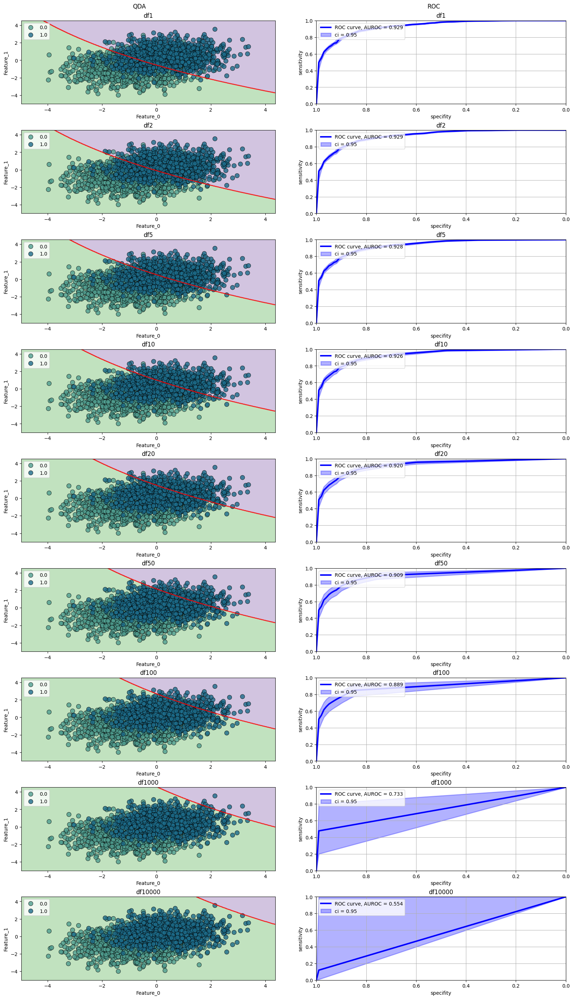

In [27]:
N_BOOTSTRAPS = 1000
CLASS_0 = 0
CLASS_1 = 1
FEATURES = ["Feature_0", "Feature_1"]
ci = 0.95

fig = plt.figure(layout="constrained", figsize=[16, 28])
subfigs = fig.subfigures(1, 2, wspace=0.07)
qda_axs = subfigs[0].subplots(nrows, 1)
subfigs[0].suptitle("QDA")
roc_axs = subfigs[1].subplots(nrows, 1)
subfigs[1].suptitle("ROC")

thresholds = np.concat((np.linspace(0, 1, 100), [np.inf]))
specifity_mean = np.linspace(0, 1, 100)
X_TO_DRAW = df_n[1][(df_n[1]["Class"] == CLASS_0) | (df_n[1]["Class"] == CLASS_1)][FEATURES]
for i, n in enumerate(N):
    QDA = QuadraticDiscriminantAnalysis()
    samples = df_n[n][(df_n[n]["Class"] == CLASS_0) | (df_n[n]["Class"] == CLASS_1)]
    x = samples[FEATURES]
    y = samples["Class"]
    y_binary = y == CLASS_1
    
    start = timer()
    QDA.fit(x, y_binary)
    end = timer()
    fitting_time = (end - start) * 100

    draw_da(QDA, X_TO_DRAW, y, qda_axs[i])
    qda_axs[i].set_title(f"df{n}")
    qda_axs[i].set_xlabel("Feature_0")
    qda_axs[i].set_ylabel("Feature_1")
    qda_axs[i].legend(loc="upper left")

    y_probs = QDA.predict_proba(x)[:, 1]
    sensitivity_interp, auroc = compute_roc_curve(y_binary, y_probs, specifity_mean, thresholds)
    draw_roc(specifity_mean, sensitivity_interp, auroc, roc_axs[i])
    sensitivity_ci = compute_roc_ci(specifity_mean, y_binary, y_probs, N_BOOTSTRAPS, ci, thresholds)
    draw_ci(specifity_mean, sensitivity_ci, ci, roc_axs[i])
    roc_axs[i].set_title(f"df{n}")
    roc_axs[i].legend(loc="upper left")

    print(f"df{n}")
    print(f"Time spent on making a solution: {fitting_time:.4f} ms")